# Importing Libraries

In [1]:
pip install tf-explain

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 3.3 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [2]:
import os
import sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from keras.utils import to_categorical
from keras import optimizers
from keras import layers
from keras import models
from keras.preprocessing.image import ImageDataGenerator
from keras.applications.vgg19 import preprocess_input
from keras.models import load_model
import keras.utils as image
from keras.layers import Input, Dense, Activation, Dropout, Flatten, Conv2D, MaxPooling2D
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
from tensorflow.keras.applications.vgg19 import VGG19
from tensorflow.keras.applications import ResNet50
from sklearn.model_selection import train_test_split
from PIL import Image
import cv2
import random
from tf_explain.core.grad_cam import GradCAM
from tqdm import tqdm
from keras.callbacks import LearningRateScheduler

# Data Visualization and preparation

In [3]:
train_dir = '/kaggle/input/state-farm-distracted-driver-detection/imgs/train'
df_train = pd.read_csv('/kaggle/input/state-farm-distracted-driver-detection/driver_imgs_list.csv')
df_test = pd.read_csv('/kaggle/input/state-farm-distracted-driver-detection/sample_submission.csv')

df_train['path'] = train_dir + '/' + df_train['classname']+ '/' + df_train['img']

In [4]:
df_train.head()

,subject,classname,img,path
0,p002,c0,img_44733.jpg,/kaggle/input/state-farm-distracted-driver-det...
1,p002,c0,img_72999.jpg,/kaggle/input/state-farm-distracted-driver-det...
2,p002,c0,img_25094.jpg,/kaggle/input/state-farm-distracted-driver-det...
3,p002,c0,img_69092.jpg,/kaggle/input/state-farm-distracted-driver-det...
4,p002,c0,img_92629.jpg,/kaggle/input/state-farm-distracted-driver-det...


In [6]:
classes = {
          'c0': 'normal driving',
          'c1': 'texting - right',
          'c2': 'talking on the phone - right',
          'c3': 'texting - left',
          'c4': 'talking on the phone - left',
          'c5': 'operating the radio',
          'c6': 'drinking',
          'c7': 'reaching behind',
          'c8': 'hair and makeup',
          'c9': 'talking to passenger'}

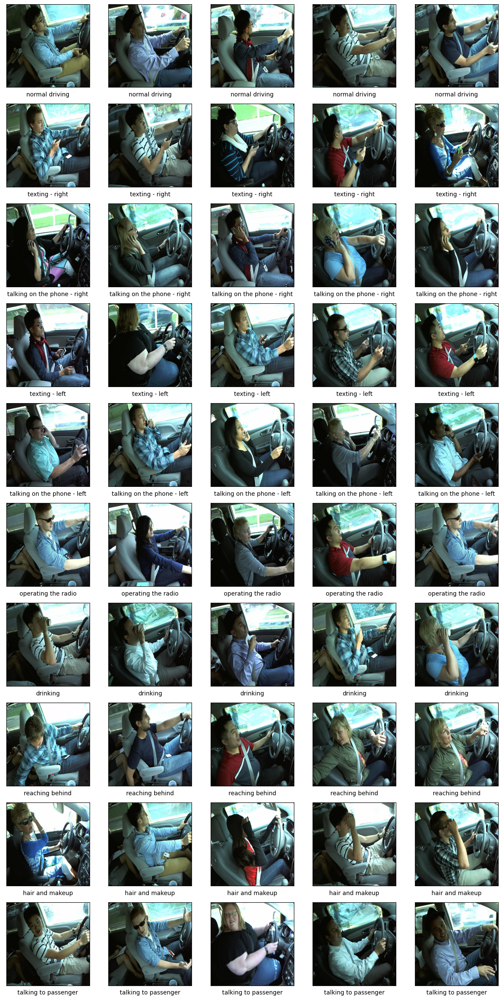

In [7]:
plt.figure(figsize=(15, 30))
for ind, i in enumerate(classes.keys()):
  for n in range(5):
    plt.subplot(10, 5, (5 * ind) + n + 1)
    img_path = f"{train_dir}/{i}/{random.sample(os.listdir(f'{train_dir}/{i}'),1)[0]}"
    img = Image.open(img_path)
    img = img.resize((224,224))
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(img)
    plt.xlabel(classes[i])

## Split the data

In [8]:
X, y = df_train[['path', 'classname']], df_train['classname']

In [9]:
X_train, X_val, _, _ = train_test_split(X, y, stratify= y ,test_size=0.2, random_state=42)

In [10]:
X_train.head()

,path,classname
21215,/kaggle/input/state-farm-distracted-driver-det...,c5
9396,/kaggle/input/state-farm-distracted-driver-det...,c1
4915,/kaggle/input/state-farm-distracted-driver-det...,c4
6235,/kaggle/input/state-farm-distracted-driver-det...,c4
20435,/kaggle/input/state-farm-distracted-driver-det...,c9


# Building custom network

In [11]:
model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Flatten())
model.add(layers.Dense(512, activation='relu'))
model.add(layers.Dense(10, activation='softmax'))

In [12]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 111, 111, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 54, 54, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 52, 52, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 26, 26, 128)      0

In [13]:
model.compile(loss='categorical_crossentropy',
              optimizer=optimizers.Adam(learning_rate = 1e-4),
              metrics=['accuracy'])

In [14]:
train_datagen  = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    zoom_range=0.10,
    channel_shift_range=0.7,
    width_shift_range=0.15,
    height_shift_range=0.15,
    shear_range=0.15,
    horizontal_flip=True,
    fill_mode='nearest'
) 

# Note that the validation data should not be augmented!
test_datagen = ImageDataGenerator(rescale=1./255)

In [15]:
train_generator = train_datagen .flow_from_dataframe(
        dataframe=X_train, 
        x_col='path',
        y_col = 'classname', 
        class_mode='categorical',
        # All images will be resized to 224*224
        target_size=(224, 224),
        batch_size=64,
)

validation_generator = test_datagen .flow_from_dataframe(
        dataframe=X_val,
        x_col = 'path', 
        y_col = 'classname', 
        class_mode='categorical',
        # All images will be resized to 224*224
        target_size=(224, 224),
        batch_size=64,
)

Found 17939 validated image filenames belonging to 10 classes.
Found 4485 validated image filenames belonging to 10 classes.


In [16]:
for data_batch, labels_batch in train_generator:
    print('data batch shape:', data_batch.shape)
    print('labels batch shape:', labels_batch.shape)
    break

data batch shape: (64, 224, 224, 3)
labels batch shape: (64, 10)


In [17]:
history = model.fit(
          train_generator,
          steps_per_epoch = len(X_train) // 64,
          epochs=5,
          validation_data=validation_generator,
          validation_steps=len(X_val) // 64)

Epoch 1/5
280/280 [==============================] - 448s 2s/step - loss: 2.1902 - accuracy: 0.1870 - val_loss: 1.7487 - val_accuracy: 0.4069
Epoch 2/5
280/280 [==============================] - 326s 1s/step - loss: 1.7422 - accuracy: 0.3797 - val_loss: 1.2065 - val_accuracy: 0.5982
Epoch 3/5
280/280 [==============================] - 326s 1s/step - loss: 1.3611 - accuracy: 0.5356 - val_loss: 0.8685 - val_accuracy: 0.6949
Epoch 4/5
280/280 [==============================] - 324s 1s/step - loss: 1.0778 - accuracy: 0.6372 - val_loss: 0.6329 - val_accuracy: 0.7859
Epoch 5/5
280/280 [==============================] - 329s 1s/step - loss: 0.8597 - accuracy: 0.7128 - val_loss: 0.4846 - val_accuracy: 0.8395


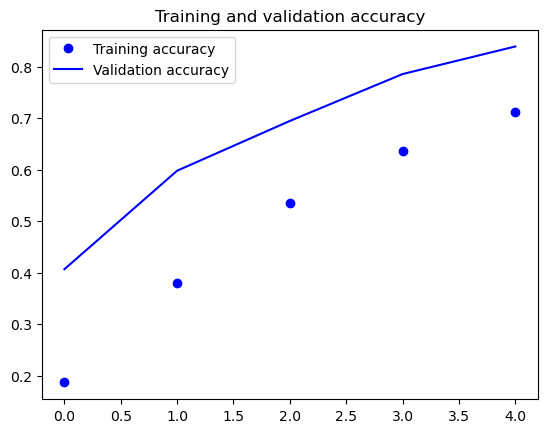

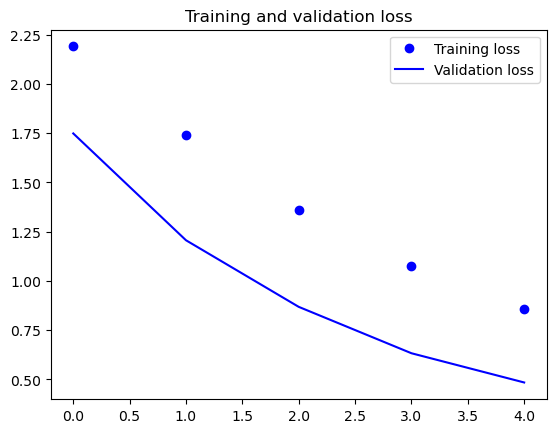

In [18]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'bo', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

# Using VGG19 Pretrained Model

In [19]:
vgg19 = VGG19(weights='imagenet',
                  include_top=False,
                  input_shape=(224,224,3))

80134624/80134624 [==============================] - 0s 0us/step


In [20]:
vgg19.trainable = False
vgg19.summary()

Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [21]:
last = vgg19.output
x = layers.Flatten()(last)
x = layers.Dropout(0.3)(x)
output = layers.Dense(10, activation='softmax')(x)
model = models.Model(vgg19.input, output)

model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [22]:
train_datagen  = ImageDataGenerator(
    preprocessing_function= preprocess_input,
    rotation_range=20,
    zoom_range=0.10,
    channel_shift_range=0.7,
    width_shift_range=0.15,
    height_shift_range=0.15,
    shear_range=0.15,
    horizontal_flip=True,
    fill_mode='nearest'
) 

# Note that the validation data should not be augmented!
test_datagen = ImageDataGenerator(preprocessing_function= preprocess_input)

In [23]:
train_generator = train_datagen.flow_from_dataframe(
        dataframe=X_train, 
        x_col='path',
        y_col = 'classname', 
        class_mode='categorical',
        # All images will be resized to 224*224
        target_size=(224, 224),
        batch_size=64,
)

validation_generator = test_datagen.flow_from_dataframe(
        dataframe=X_val,
        x_col = 'path', 
        y_col = 'classname', 
        class_mode='categorical',
        # All images will be resized to 224*224
        target_size=(224, 224),
        batch_size=64,
)

Found 17939 validated image filenames belonging to 10 classes.
Found 4485 validated image filenames belonging to 10 classes.


In [24]:
model.compile(optimizer= optimizers.Adam(learning_rate = 0.001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

In [25]:
checkpoint = ModelCheckpoint('pre_model.h5', monitor='val_accuracy', save_best_only=True, mode='max')
my_callbacks = [EarlyStopping(patience = 3, restore_best_weights= True), checkpoint]

In [26]:
history = model.fit(
          train_generator,
          steps_per_epoch = len(X_train) // 64,
          epochs=7,
          validation_data=validation_generator,
          validation_steps=len(X_val) // 64,
          callbacks = my_callbacks)

Epoch 1/7
280/280 [==============================] - 330s 1s/step - loss: 10.1618 - accuracy: 0.6145 - val_loss: 2.5585 - val_accuracy: 0.9116
Epoch 2/7
280/280 [==============================] - 329s 1s/step - loss: 6.1826 - accuracy: 0.7898 - val_loss: 2.8915 - val_accuracy: 0.9083
Epoch 3/7
280/280 [==============================] - 327s 1s/step - loss: 5.5780 - accuracy: 0.8246 - val_loss: 2.6606 - val_accuracy: 0.9326
Epoch 4/7
280/280 [==============================] - 333s 1s/step - loss: 5.6740 - accuracy: 0.8451 - val_loss: 1.9169 - val_accuracy: 0.9429
Epoch 5/7
280/280 [==============================] - 341s 1s/step - loss: 5.2480 - accuracy: 0.8617 - val_loss: 2.1109 - val_accuracy: 0.9563
Epoch 6/7
280/280 [==============================] - 334s 1s/step - loss: 5.5673 - accuracy: 0.8671 - val_loss: 1.9449 - val_accuracy: 0.9589
Epoch 7/7
280/280 [==============================] - 332s 1s/step - loss: 5.3376 - accuracy: 0.8782 - val_loss: 1.7449 - val_accuracy: 0.9614


# Fine tune VGG19

In [27]:
# def lr_scheduler(epoch):
#     initial_lr = 1e-5
#     drop = 0.1
#     epochs_drop = 7
#     lr = initial_lr * drop**((epoch)//epochs_drop)
#     return lr

# reduce_lr = LearningRateScheduler(lr_scheduler)

In [28]:
checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max')
my_callbacks = [EarlyStopping(patience = 3, restore_best_weights= True), checkpoint, ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience = 1, min_lr=1e-7)]

In [29]:
model.trainable = True
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [30]:
model.compile(optimizer= optimizers.Adam(learning_rate = 1e-5),
                    loss='categorical_crossentropy',
                    metrics=['accuracy'])

In [31]:
history = model.fit(
                    train_generator,
                    steps_per_epoch = len(X_train) // 64,
                    epochs=30,
                    validation_data=validation_generator,
                    validation_steps=len(X_val) // 64,
                    callbacks = my_callbacks,
                    )

Epoch 1/30
280/280 [==============================] - 373s 1s/step - loss: 1.9897 - accuracy: 0.8940 - val_loss: 0.3216 - val_accuracy: 0.9737 - lr: 1.0000e-05
Epoch 2/30
280/280 [==============================] - 371s 1s/step - loss: 0.6478 - accuracy: 0.9148 - val_loss: 0.1834 - val_accuracy: 0.9761 - lr: 1.0000e-05
Epoch 3/30
280/280 [==============================] - 367s 1s/step - loss: 0.3794 - accuracy: 0.9343 - val_loss: 0.1464 - val_accuracy: 0.9783 - lr: 1.0000e-05
Epoch 4/30
280/280 [==============================] - 366s 1s/step - loss: 0.2608 - accuracy: 0.9460 - val_loss: 0.0918 - val_accuracy: 0.9842 - lr: 1.0000e-05
Epoch 5/30
280/280 [==============================] - 370s 1s/step - loss: 0.2335 - accuracy: 0.9482 - val_loss: 0.0929 - val_accuracy: 0.9839 - lr: 1.0000e-05
Epoch 6/30
280/280 [==============================] - 369s 1s/step - loss: 0.1647 - accuracy: 0.9617 - val_loss: 0.0719 - val_accuracy: 0.9877 - lr: 5.0000e-06
Epoch 7/30
280/280 [====================

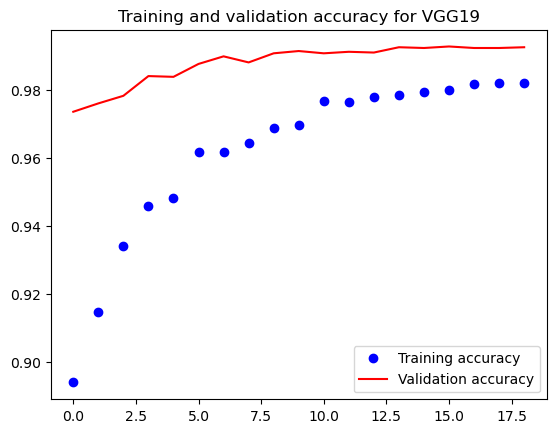

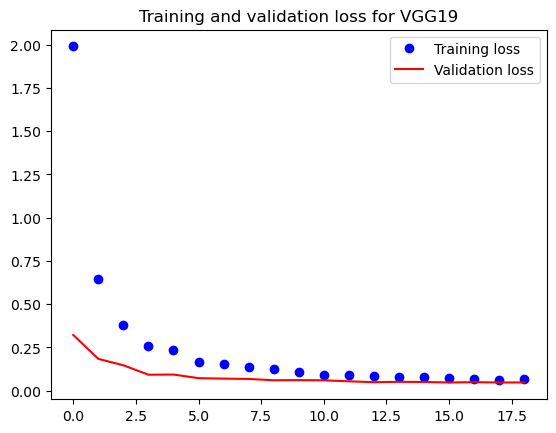

In [32]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'bo', label='Training accuracy')
plt.plot(epochs, val_acc, 'r', label='Validation accuracy')
plt.title('Training and validation accuracy for VGG19')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss for VGG19')
plt.legend()

plt.show()

# Visualizing VGG19 intermediate activations

In [33]:
# Step 1: we will load the VGG19 model as follows:
# model = load_model('/kaggle/input/state-farm-distracted-driver-detection/best_model.h5')
model.summary()  # As a reminder.

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [34]:
layer1 = models.Model(inputs=model.input, outputs=model.get_layer('block1_conv1').output)
layer2 = models.Model(inputs=model.input, outputs=model.get_layer('block3_conv1').output)
layer3 = models.Model(inputs=model.input, outputs=model.get_layer('block5_conv4').output)



 ************************************************************ Normal driving ************************************************************ 




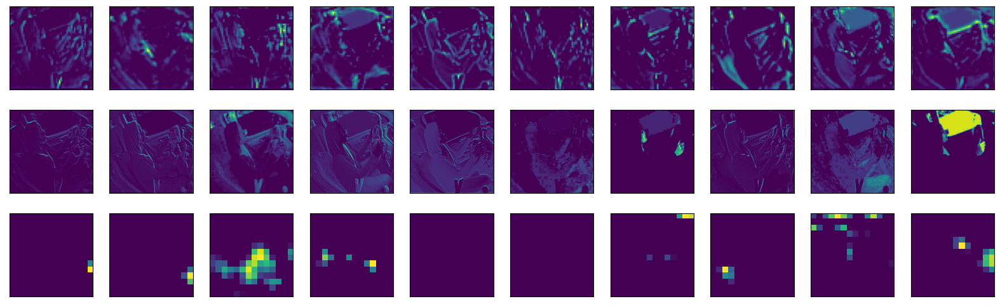



 ************************************************************ Texting - right ************************************************************ 




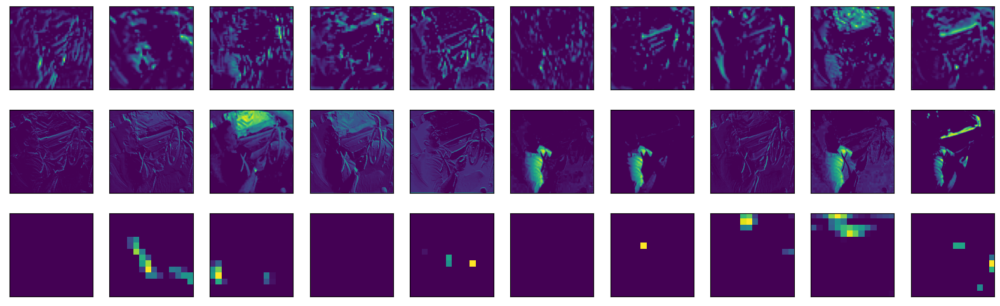



 ************************************************************ Talking on the phone - right ************************************************************ 




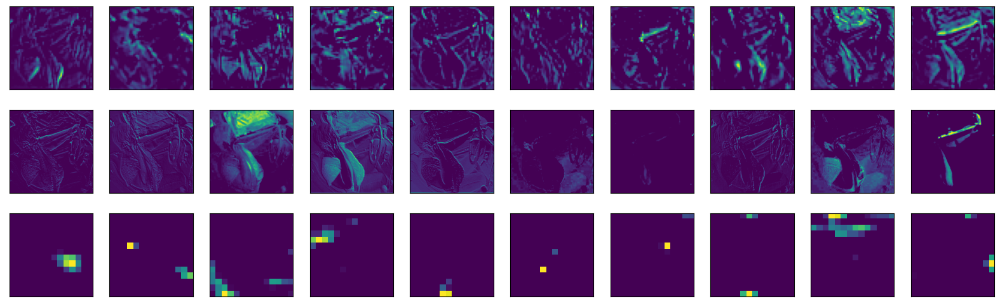



 ************************************************************ Texting - left ************************************************************ 




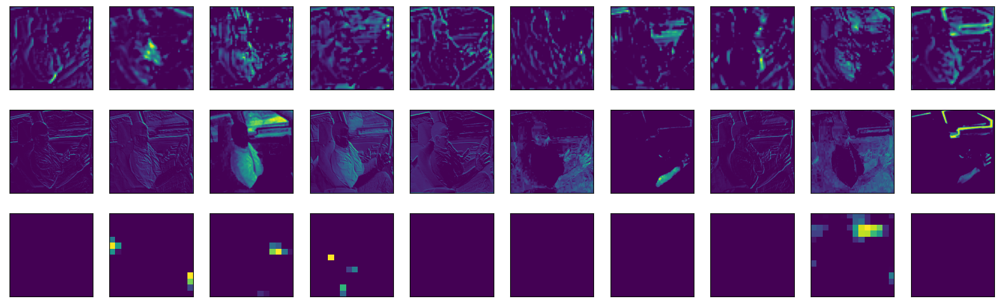



 ************************************************************ Talking on the phone - left ************************************************************ 




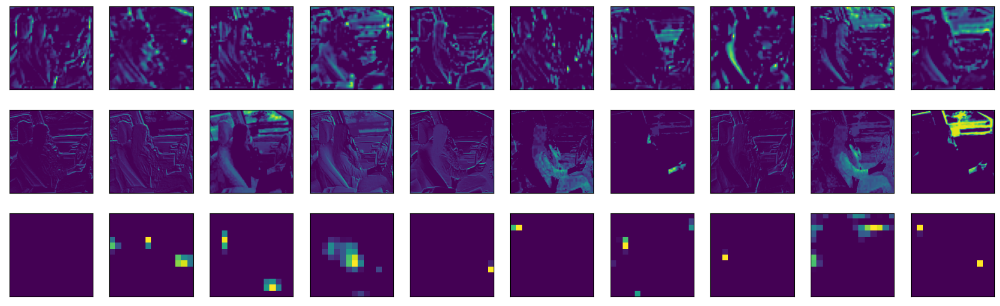



 ************************************************************ Operating the radio ************************************************************ 




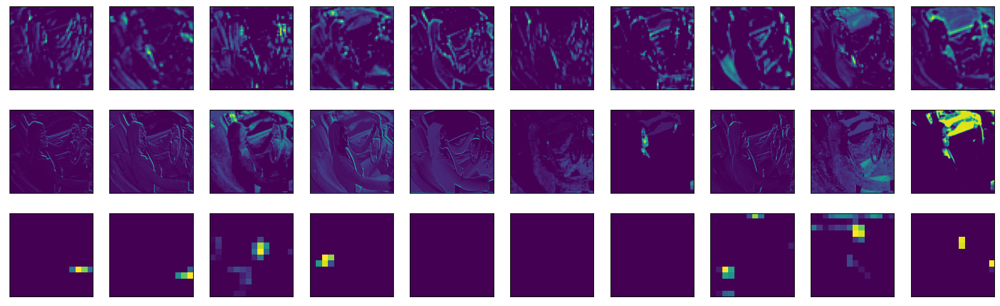



 ************************************************************ Drinking ************************************************************ 




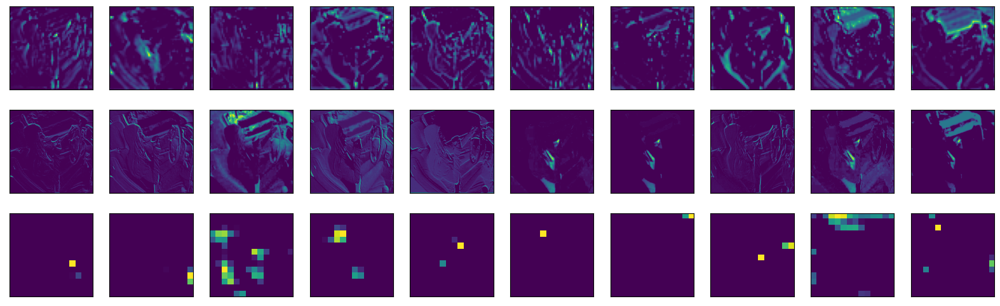



 ************************************************************ Reaching behind ************************************************************ 




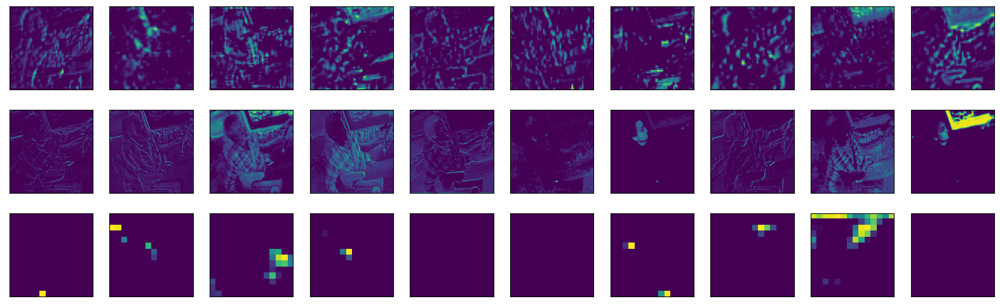



 ************************************************************ Hair and makeup ************************************************************ 




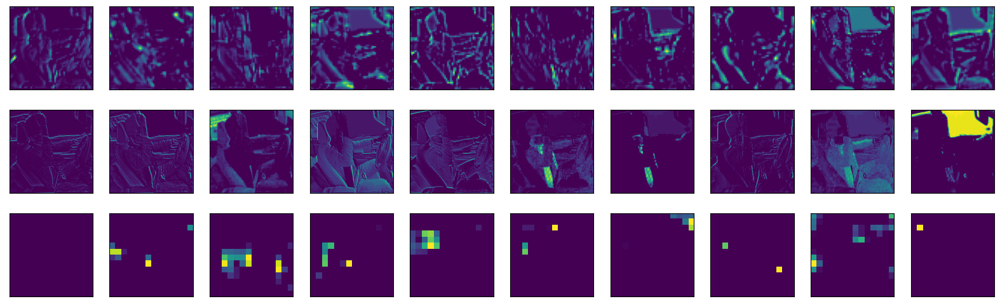



 ************************************************************ Talking to passenger ************************************************************ 




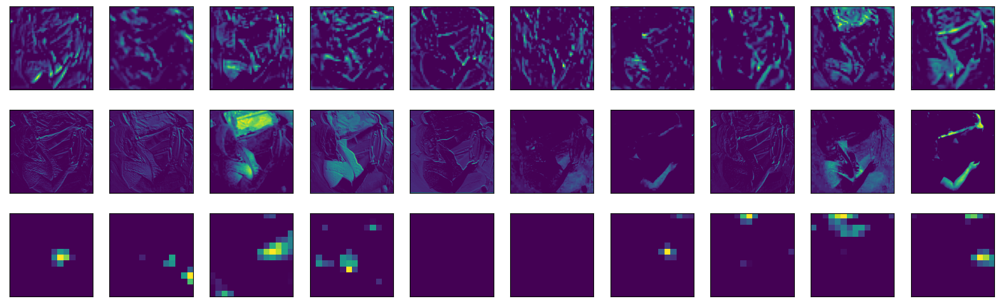

In [35]:
for ind, i in enumerate(classes.keys()):
  # Make sure to resize the image to the appropriate size expected by the VGG19 model.

  img_path = f"{train_dir}/{i}/{random.sample(os.listdir(f'{train_dir}/{i}'),1)[0]}"
  img = image.load_img(img_path, target_size=(224, 224))
  x = image.img_to_array(img)
  x = np.expand_dims(x, axis=0)
  x = preprocess_input(x)

  # Get the intermediate layer outputs
  # To get the intermediate layer outputs, we can use the Model class in Keras. we need to specify the input and output layers, and then call the predict method on the model.

  layer1_activations = layer1.predict(x, verbose= 0)
  layer2_activations = layer2.predict(x, verbose= 0)
  layer3_activations = layer3.predict(x, verbose= 0) 

  print('\n\n','*' * 60, classes[i].capitalize(), '*' * 60, '\n\n')
  plt.figure(figsize=(20, 6))

  # Visualize the intermediate activations
  # Finally, you can visualize the intermediate activations using any visualization tool you prefer, such as Matplotlib. You can choose a layer to visualize and plot the activations as follows:

  for i in range(10):
    
    plt.subplot(3, 10, i+1)
    plt.imshow(layer2_activations[0, :, :, i], cmap='viridis')
    plt.xticks([])
    plt.yticks([])

    plt.subplot(3, 10, i+11)
    plt.imshow(layer1_activations[0, :, :, 10 + i], cmap='viridis')
    plt.xticks([])
    plt.yticks([])

    plt.subplot(3, 10, i + 21)
    plt.imshow(layer3_activations[0, :, :, 20 + i], cmap='viridis')
    plt.xticks([])
    plt.yticks([])
  plt.show()

# Visualizing heatmaps of class activation (Grad-CAM)


In [36]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [ ]:
img_path = f"{train_dir}/c7/{random.sample(os.listdir(f'{train_dir}/c7'),1)[0]}"
img = image.load_img(img_path, target_size=(224, 224))


In [38]:
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)
x = preprocess_input(x)

In [39]:
preds = model.predict(x, verbose= 0)
print('Predicted:', classes[f'c{preds.argmax()}'], f', probability: {(preds.max()) * 100}%')

Predicted: reaching behind , probability: 99.99955892562866%


To visualize which parts of our image were the most related to the predicted class,  let's set up the Grad-CAM process.

In [40]:
def Heatmap(class_name, outputs):
    fig = plt.figure(figsize=(20, 8))
    print('\n\n','*' * 60, classes[class_name].capitalize(), '*' * 60, '\n\n')
    for i in range(10):
      plt.subplot(2, 5, i + 1)
      plt.imshow(outputs[i])
      plt.xticks([])
      plt.yticks([])
    plt.show()



 ************************************************************ Normal driving ************************************************************ 




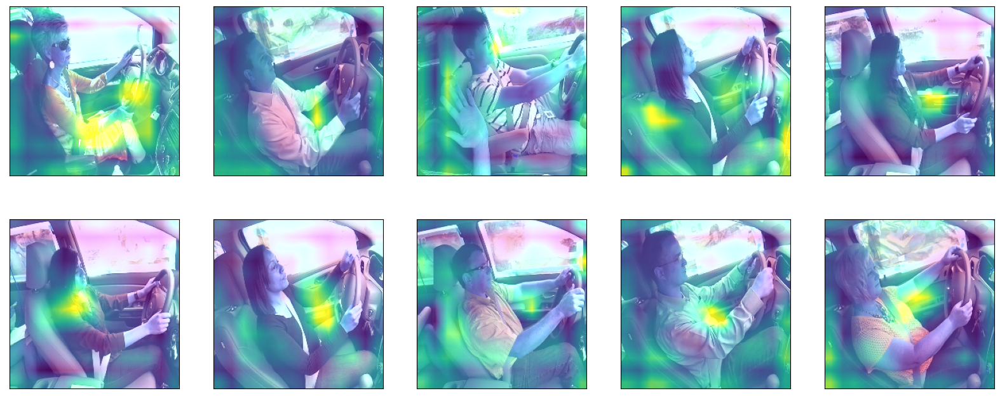



 ************************************************************ Texting - right ************************************************************ 




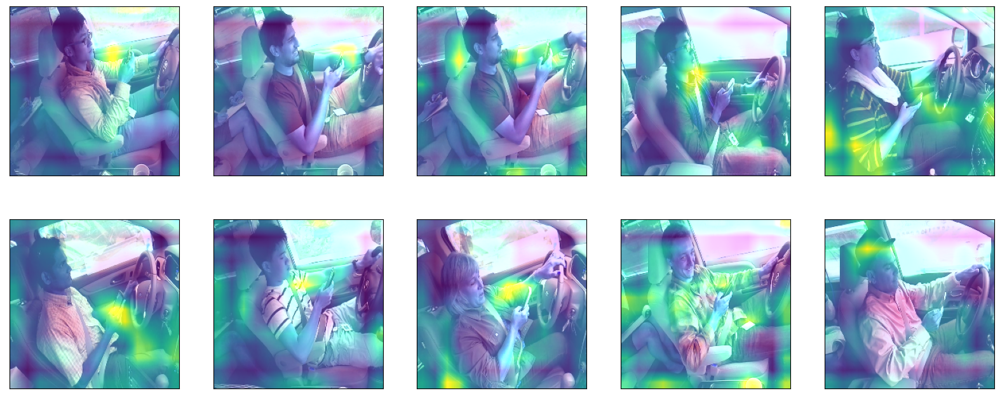



 ************************************************************ Talking on the phone - right ************************************************************ 




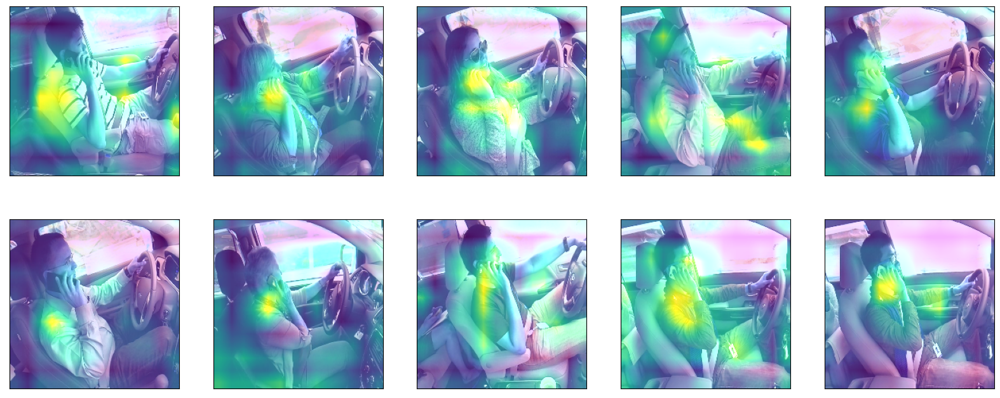



 ************************************************************ Texting - left ************************************************************ 




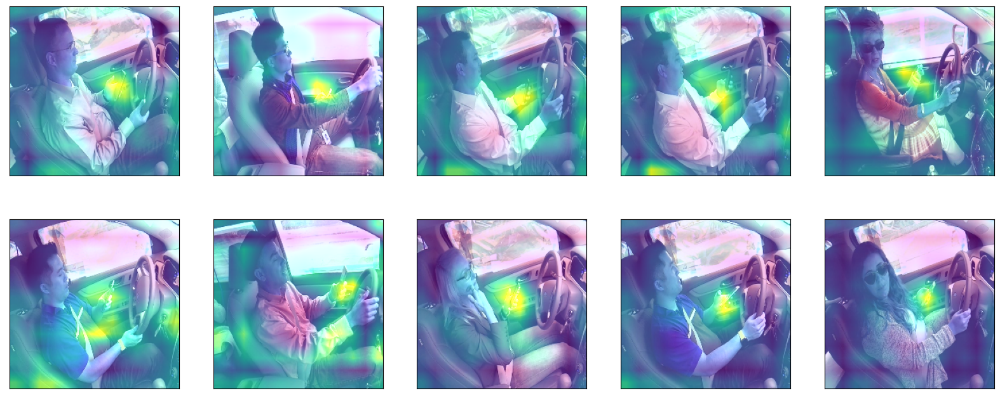



 ************************************************************ Talking on the phone - left ************************************************************ 




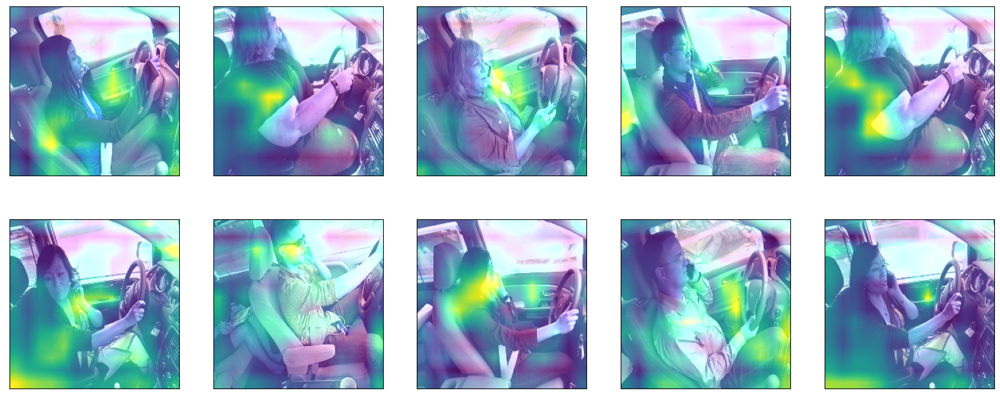



 ************************************************************ Operating the radio ************************************************************ 




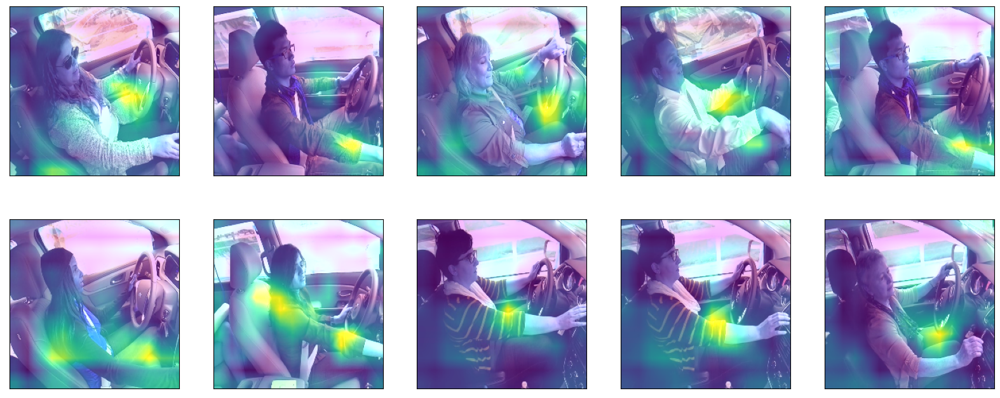



 ************************************************************ Drinking ************************************************************ 




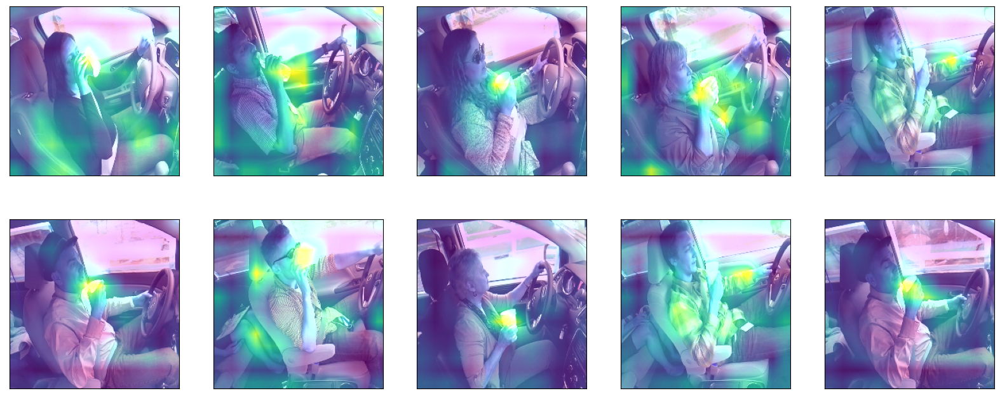



 ************************************************************ Reaching behind ************************************************************ 




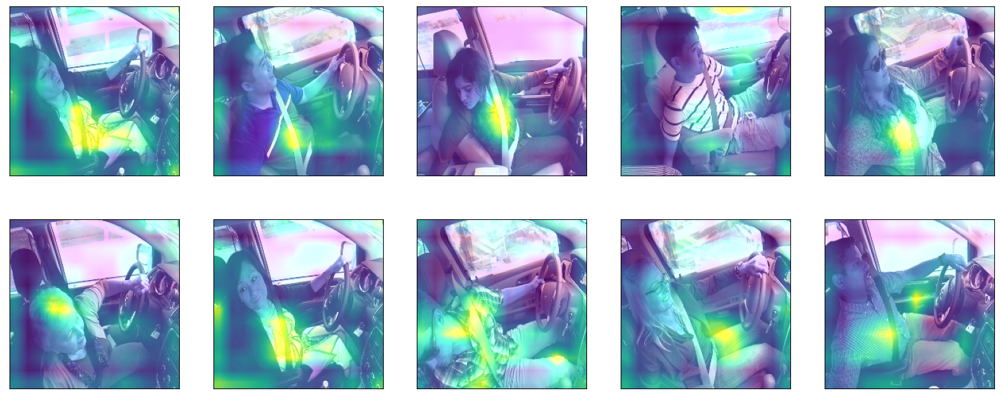



 ************************************************************ Hair and makeup ************************************************************ 




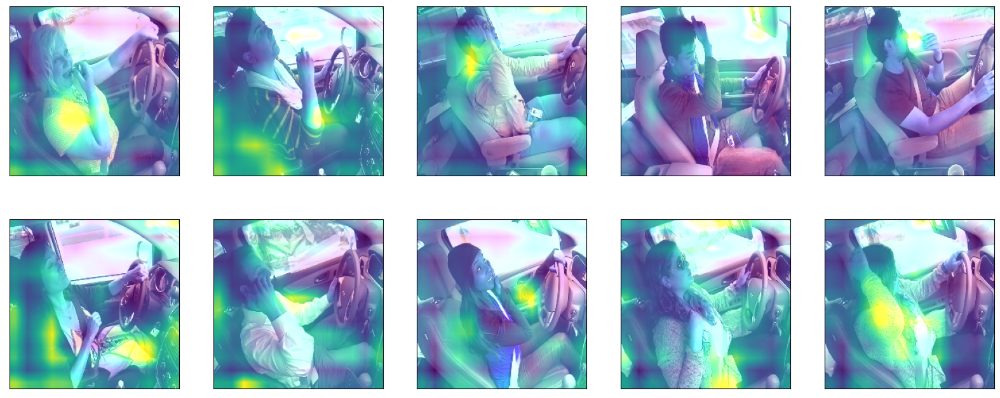



 ************************************************************ Talking to passenger ************************************************************ 




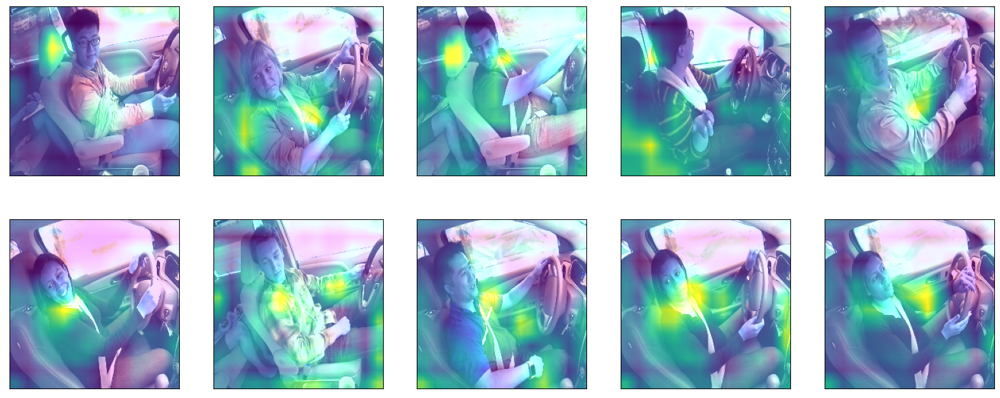

In [41]:
for idx, class_name in enumerate(classes.keys()):
  output_data = []
  for i in range(10):
      # Load an image to test the model on
      img_path = f"{train_dir}/{class_name}/{random.sample(os.listdir(f'{train_dir}/{class_name}'),1)[0]}"
      img = cv2.imread(img_path)
      img = cv2.resize(img, (224,224))
      data = ([img], None)

      # Use the GradCAM to generate the heatmap
      explainer = GradCAM()
      output = explainer.explain(validation_data = data, model = model, class_index = idx, layer_name = 'block5_conv4')
      output_data.append(output)
  Heatmap(class_name, output_data)

# Prediction

In [42]:
df_test['img']

0             img_1.jpg
1            img_10.jpg
2           img_100.jpg
3          img_1000.jpg
4        img_100000.jpg
              ...      
79721     img_99994.jpg
79722     img_99995.jpg
79723     img_99996.jpg
79724     img_99998.jpg
79725     img_99999.jpg
Name: img, Length: 79726, dtype: object

In [43]:
df_test['path'] = '/kaggle/input/state-farm-distracted-driver-detection/imgs/test' + '/' + df_test['img']

In [44]:
batch_size = 64

In [45]:
test_datagen = ImageDataGenerator(preprocessing_function= preprocess_input)
test_generator = test_datagen.flow_from_dataframe(
        dataframe=df_test,
        x_col = 'path', 
        y_col = None,
        class_mode=None,
        # All images will be resized to 224*224
        target_size=(224, 224),
        batch_size=batch_size,
        shuffle = False
)

Found 79726 validated image filenames.


In [46]:
predictions = model.predict(test_generator, steps = len(df_test) // batch_size + 1)

1246/1246 [==============================] - 1037s 832ms/step


In [47]:
predictions.shape

(79726, 10)

In [48]:
df_test.drop(columns = 'path', inplace = True)

In [49]:
df_test.iloc[:, 1:] = predictions

In [50]:
df_test.head()

,img,c0,c1,c2,c3,c4,c5,c6,c7,c8,c9
0,img_1.jpg,2.629742e-09,1.002334e-11,2.558924e-07,5.101861e-09,6.018128e-07,9.999943e-01,2.100007e-07,2.766993e-11,2.698934e-08,4.603466e-06
1,img_10.jpg,1.344750e-13,1.377945e-18,3.063415e-14,2.030210e-19,1.804183e-13,1.000000e+00,3.109219e-17,5.316120e-12,5.335859e-15,2.390396e-17
2,img_100.jpg,1.085922e-03,3.255519e-05,6.119379e-11,9.982792e-01,1.337800e-12,2.719321e-04,1.367452e-09,2.334334e-08,3.271507e-05,2.975977e-04
3,img_1000.jpg,2.258147e-15,2.230017e-16,2.595838e-14,5.217533e-20,9.130023e-20,2.205997e-23,3.212264e-17,3.005880e-23,1.000000e+00,9.625680e-23
4,img_100000.jpg,2.188202e-02,8.827730e-08,2.799025e-07,9.773790e-01,5.885240e-04,1.347009e-04,2.914966e-08,2.506191e-11,1.473619e-09,1.539328e-05


In [51]:
df_test.to_csv('/kaggle/working/submission.csv', index=False)